## Datenakquise und -vorverarbeitung

In [1]:
import requests
import json
import pandas as pd
import numpy as np
import pickle

from zipfile import ZipFile
from io import BytesIO
import os
import warnings

### Daten von API direkt abfragen (veraltet)

In [2]:
response = requests.get("https://api.fda.gov/drug/event.json?api_key=um3WNQBC5XLxHLmhGBxjTxc6iLPOkporlRb8E4ka&sort=receivedate:desc&limit=1000")
data = response.json()
data

{'meta': {'disclaimer': 'Do not rely on openFDA to make decisions regarding medical care. While we make every effort to ensure that data is accurate, you should assume all results are unvalidated. We may limit or otherwise restrict your access to the API in line with our Terms of Service.',
  'terms': 'https://open.fda.gov/terms/',
  'license': 'https://open.fda.gov/license/',
  'last_updated': '2023-04-27',
  'results': {'skip': 0, 'limit': 1000, 'total': 16364554}},
 'results': [{'safetyreportversion': '1',
   'safetyreportid': '22158205',
   'primarysourcecountry': 'US',
   'occurcountry': 'US',
   'transmissiondateformat': '102',
   'transmissiondate': '20230417',
   'reporttype': '1',
   'serious': '2',
   'seriousnessdeath': '2',
   'seriousnesslifethreatening': '2',
   'seriousnesshospitalization': '2',
   'seriousnessdisabling': '2',
   'seriousnesscongenitalanomali': '2',
   'seriousnessother': '2',
   'receivedateformat': '102',
   'receivedate': '20230331',
   'receiptdatefo

In [3]:
# Funktion, um Daten zu holen und zu flatten
# Nicht sinnvoll, da zu viele Spalten mit vielen NaNs
'''
def get_and_flatten_data(url):
    response = requests.get(url)
    print(response.status_code)
    data = response.json()
    data
    dic_flattened = [flatten(d) for d in data['results']]
    df = pd.DataFrame(dic_flattened)
    return df
'''

"\ndef get_and_flatten_data(url):\n    response = requests.get(url)\n    print(response.status_code)\n    data = response.json()\n    data\n    dic_flattened = [flatten(d) for d in data['results']]\n    df = pd.DataFrame(dic_flattened)\n    return df\n"

In [ ]:
# hier Kennzahl tracken, ob erfolgreich / wie viele Daten 
def get_data(url):
    response = requests.get(url)
    data = response.json()
    df = pd.json_normalize(data['results'])
    return df

In [ ]:
newest_data = get_data("https://api.fda.gov/drug/event.json?api_key=um3WNQBC5XLxHLmhGBxjTxc6iLPOkporlRb8E4ka&sort=receivedate:desc&limit=1000")

### 2019 Daten runterladen

In [5]:
r = open("../Daten/all_dl_links.json")
data = json.load(r)
files = pd.DataFrame(data['results']['drug']['event']['partitions'])
files = files[files[files['display_name'].str.contains('2019 Q1')].index[0]:files[files['display_name'].str.contains('2020 Q1')].index[0]].reset_index(drop=True)

In [6]:
files

,display_name,file,size_mb,records
0,2019 Q1 (part 1 of 30),https://download.open.fda.gov/drug/event/2019q...,36.31,12000
1,2019 Q1 (part 2 of 30),https://download.open.fda.gov/drug/event/2019q...,75.91,12000
2,2019 Q1 (part 3 of 30),https://download.open.fda.gov/drug/event/2019q...,24.00,12000
3,2019 Q1 (part 4 of 30),https://download.open.fda.gov/drug/event/2019q...,93.02,12000
4,2019 Q1 (part 5 of 30),https://download.open.fda.gov/drug/event/2019q...,137.18,12000
...,...,...,...,...
117,2019 Q4 (part 25 of 29),https://download.open.fda.gov/drug/event/2019q...,133.91,12000
118,2019 Q4 (part 26 of 29),https://download.open.fda.gov/drug/event/2019q...,122.31,12000
119,2019 Q4 (part 27 of 29),https://download.open.fda.gov/drug/event/2019q...,127.97,12000
120,2019 Q4 (part 28 of 29),https://download.open.fda.gov/drug/event/2019q...,135.53,12000


In [7]:
for i in files.file:
    r = requests.get(i)
    z = ZipFile(BytesIO(r.content))
    z.extractall(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\2019")

### Daten über Link downloaden

In [4]:
def all_data_since_2020(api_url):
    try:
        r = requests.get(api_url)
        print("API Request successful")
        data = r.json()
    except: 
        r = open("../Daten/all_dl_links.json")
        warnings.warn("API-Url wrong or not available. Maybe outdated downloaded data list is used.")
        data = json.load(r)
    finally: 
        files = pd.DataFrame(data['results']['drug']['event']['partitions'])
        files = files[files[files['display_name'].str.contains('2020 Q1')].index[0]:].reset_index(drop=True)
        return files

In [5]:
files = all_data_since_2020("https://api.fda1.gov/download.json")

C:\Users\Paul Strohmeier\AppData\Local\Temp\ipykernel_5716\378617045.py:8: UserWarning: API-Url wrong or not available. Maybe outdated downloaded data list is used.
  warnings.warn("API-Url wrong or not available. Maybe outdated downloaded data list is used.")


In [32]:
files

,display_name,file,size_mb,records
0,2020 Q1 (part 1 of 33),https://download.open.fda.gov/drug/event/2020q...,37.56,12000
1,2020 Q1 (part 2 of 33),https://download.open.fda.gov/drug/event/2020q...,14.04,12000
2,2020 Q1 (part 3 of 33),https://download.open.fda.gov/drug/event/2020q...,53.06,12000
3,2020 Q1 (part 4 of 33),https://download.open.fda.gov/drug/event/2020q...,85.45,12000
4,2020 Q1 (part 5 of 33),https://download.open.fda.gov/drug/event/2020q...,150.02,12000
...,...,...,...,...
429,2023 Q1 (part 33 of 37),https://download.open.fda.gov/drug/event/2023q...,186.73,12000
430,2023 Q1 (part 34 of 37),https://download.open.fda.gov/drug/event/2023q...,202.08,12000
431,2023 Q1 (part 35 of 37),https://download.open.fda.gov/drug/event/2023q...,190.08,12000
432,2023 Q1 (part 36 of 37),https://download.open.fda.gov/drug/event/2023q...,179.59,12000


In [33]:
sum(pd.to_numeric(files.size_mb))

31101.409999999993

In [37]:
files.display_name[0][0:7]

'2020 Q1'

In [16]:
counter_file = '../Daten/counter.json'

# Lesen des aktuellen Counter-Werts aus der Datei
with open(counter_file, 'r') as file:
    data = json.load(file)
    counter = data['counter']

In [18]:
# Daten mit Link aus Files herunterladen

# Lesen des aktuellen Counter-Werts aus der Datei
counter_file = '../Daten/counter.json'

with open(counter_file, 'r') as file:
    data = json.load(file)
    counter = data['counter']

if counter > len(files) - 1:
    # Weitere Bearbeitung beenden, da keine neuen Daten
    warnings.warn("Keine neuen Daten vorhanden. Counter bleibt bei {}.".format(counter))
else:
    zipurl = files.file[counter]
    print("Download gestartet")
    req = requests.get(zipurl)
    print("Download abgeschlossen")
    z = ZipFile(BytesIO(req.content))
    z.extractall("../Daten/{}".format(files.display_name[counter][0:7]))
    print("JSON-Datei entpackt")
    counter += 1
    print("Counter hochgezählt. Dieser ist nun {}.".format(counter))
    
    # Speichern des aktualisierten Counter-Werts in der Datei
    with open(counter_file, 'w') as file:
        data = {'counter': counter}
        json.dump(data, file)
    print("Counter-Datei aktualisiert.")

Download gestartet
Download abgeschlossen
JSON-Datei entpackt
Counter hochgezählt. Dieser ist nun 1.


In [9]:
counter

434

In [6]:
folder_path = "../Daten/{}".format(files.display_name[0][0:7])

In [7]:
file_path = os.path.join(folder_path, (os.listdir(folder_path)[-1]))

In [8]:
with open(file_path, "r") as file:
    json_data = json.load(file)
    data = json_data["results"]

In [9]:
df = pd.json_normalize(data)

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12000 entries, 0 to 11999
Data columns (total 39 columns):
 #   Column                                    Non-Null Count  Dtype 
---  ------                                    --------------  ----- 
 0   safetyreportversion                       12000 non-null  object
 1   safetyreportid                            12000 non-null  object
 2   primarysourcecountry                      11331 non-null  object
 3   occurcountry                              12000 non-null  object
 4   transmissiondateformat                    12000 non-null  object
 5   transmissiondate                          12000 non-null  object
 6   reporttype                                12000 non-null  object
 7   serious                                   12000 non-null  object
 8   receivedateformat                         12000 non-null  object
 9   receivedate                               12000 non-null  object
 10  receiptdateformat                         1200

In [13]:
from evidently.test_suite import TestSuite
from evidently.tests import *
from evidently.test_preset import DataStabilityTestPreset

In [2]:
df_2019 = pd.read_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_filtered.pkl")

In [3]:
import data_preprocessing
# Für Visualisierung aufbereiten und CSV für SAS ML erstellen
df = data_preprocessing.preprocess_data(df_2019, '2019')
#df.to_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_ml_ready.pkl")

Datum formartiert.
Routen als Liste gespeichert.
min_one_pres erstellt.
Alter formatiert.
One-Hot-Encoding durchgeführt für reporttype.
One-Hot-Encoding durchgeführt für qualification.
One-Hot-Encoding durcheführt für gender.
Gewicht entfernt, da zu viele NaNs.
Serious encoded.
One-Hot-Encoding durchgeführt: Country
One-Hot-Encoding durchgeführt: Routes
Spalten alphabetisch sortiert.
CSV für ML in SAS Viya erstellt.
Daten erfolgreich vorverarbeitet.


In [ ]:
data_stability = TestSuite(tests=[DataStabilityTestPreset()])
data_stability.run(reference_data=df_2019, current_data=df)

### 2019 Daten zusammenführen

In [2]:
# Pfad zum Ordner mit den JSON-Dateien
folder_path = r"C:\Users\Paul Strohmeier\Desktop\Drug-data\2019"

# Liste zum Speichern der JSON-Daten
data = []

# JSON-Dateien im Ordner lesen
for filename in os.listdir(folder_path):
    file_path = os.path.join(folder_path, filename)
    print(file_path)
    with open(file_path, "r") as file:
        json_data = json.load(file)
        data.extend(json_data["results"])

# DataFrame erstellen
data_2019 = pd.json_normalize(data)

C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0001-of-0029.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0001-of-0030.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0001-of-0031.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0001-of-0032.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0003-of-0029.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0003-of-0030.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0003-of-0031.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0003-of-0032.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0011-of-0029.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0011-of-0030.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0011-of-0031.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0011-of-0032.json
C:\Users\Paul Strohmeier\Desktop\Drug-data\2019\drug-event-0015-of-0029.json

### Daten filtern (Spalten)

In [11]:
data_2019.safetyreportid.duplicated().sum()

0

In [3]:
# teilweise unnötige Spalten mit regex entfernen
def filter_df(data):
    cols_to_drop = ['patient.patientagegroup', 'authoritynumb', 'occurcountry', 'primarysource', 'primarysourcecountry', 'transmissiondate', 'receiptdate', 'fulfillexpeditecriteria', 'companynumb', 'duplicate', 'primarysource.literaturereference', 'patient.summary.narrativeincludeclinical']
    cols_to_drop += data.filter(regex='safety|format|reportduplicate|sender|receiver').columns.tolist()
    filtered_data = data.drop(cols_to_drop, axis=1, errors='ignore')
    return filtered_data

In [4]:
df = filter_df(data_2019)

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288000 entries, 0 to 287999
Data columns (total 17 columns):
 #   Column                         Non-Null Count   Dtype 
---  ------                         --------------   ----- 
 0   reporttype                     288000 non-null  object
 1   serious                        288000 non-null  object
 2   seriousnesshospitalization     55492 non-null   object
 3   seriousnessother               93836 non-null   object
 4   receivedate                    288000 non-null  object
 5   primarysource.reportercountry  288000 non-null  object
 6   primarysource.qualification    278539 non-null  object
 7   patient.patientonsetage        158739 non-null  object
 8   patient.patientonsetageunit    158739 non-null  object
 9   patient.patientsex             249555 non-null  object
 10  patient.reaction               288000 non-null  object
 11  patient.drug                   288000 non-null  object
 12  patient.patientweight          49300 non-nul

In [5]:
df.to_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_filtered.pkl")

### Alter vorverarbeiten

In [2]:
df = pd.read_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_filtered.pkl")

In [7]:
df['patient.patientonsetageunit'].value_counts()

patient.patientonsetageunit
801    154984
800      1411
804      1190
802      1039
803       108
805         7
Name: count, dtype: int64

- decade (800) mal 10
- monat (802), woche (803), tag (804) und stunde (805) alter auf 0?!

In [8]:
df[df['patient.patientonsetageunit'] == '800']['patient.patientonsetage']

2         10
67         7
437        3
743        5
746        5
          ..
282879     4
283093     9
287781     7
287826     3
287972     6
Name: patient.patientonsetage, Length: 1411, dtype: object

In [3]:
df['age'] = df.apply(lambda x: int(x['patient.patientonsetage'])*10 if x['patient.patientonsetageunit'] == '800' else x['patient.patientonsetage'], axis=1)
df['age'] = df.apply(lambda x: 0 if x['patient.patientonsetageunit'] in ['802', '803', '804', '805'] else x['patient.patientonsetage'], axis=1)
df.drop(['patient.patientonsetageunit'], axis=1, inplace=True)
df.drop(['patient.patientonsetage'], axis=1, inplace=True)

In [10]:
df['age'].isna().value_counts()

age
False    158739
True     129261
Name: count, dtype: int64

was mit den NaNs machen?
- auffüllen mit Mean / Med / Mode?
- Datensatz streichen?
- KNN?

In [4]:
df.dropna(subset=['age'], inplace=True)
df.reset_index(drop=True, inplace=True)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158739 entries, 0 to 158738
Data columns (total 16 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   reporttype                     158739 non-null  object        
 1   serious                        158739 non-null  object        
 2   seriousnesshospitalization     40234 non-null   object        
 3   seriousnessother               56983 non-null   object        
 4   receivedate                    158739 non-null  datetime64[ns]
 5   primarysource.reportercountry  158739 non-null  object        
 6   primarysource.qualification    151739 non-null  object        
 7   patient.patientsex             155718 non-null  object        
 8   patient.reaction               158739 non-null  object        
 9   patient.drug                   158739 non-null  object        
 10  patient.patientweight          41095 non-null   object        
 11  

### Datum

In [5]:
df.receivedate = pd.to_datetime(df.receivedate)

### Reaktionen als Liste speichern

In [11]:
df['patient.reaction'][0][0]['reactionmeddrapt']

'Drug hypersensitivity'

In [6]:
def get_reactionmeddrapt_list(row):
    reactionmeddrapt_list = []
    for reaction in row['patient.reaction']:
        reactionmeddrapt_list.append(reaction['reactionmeddrapt'])
    return reactionmeddrapt_list

df['reactions'] = df.apply(get_reactionmeddrapt_list, axis=1)
df.drop(['patient.reaction'], axis=1, inplace=True)

### Name der Medikamente

In [79]:
df['patient.drug'][0][0]['medicinalproduct']

'GABAPENTIN.'

In [7]:
def get_medicinalproduct_list(row):
    medicinalproduct_list = []
    for drug in row['patient.drug']:
        medicinalproduct_list.append(drug['medicinalproduct'])
    return medicinalproduct_list

df['drugs'] = df.apply(get_medicinalproduct_list, axis=1)

### Route der Einnahme

sollte noch weiter verarbeitet werden.
- Dummy-Variable für Einnahmemöglichkeiten?
- Word Vektorisierung oder Ähnliches

In [16]:
df['patient.drug'][0][0]['openfda']['route']

['ORAL']

In [8]:
def get_route_list(row):
    route_list = []
    for route in row['patient.drug']:
        if 'openfda' in route and 'route' in route['openfda']:
            route_list.append(route['openfda']['route'][0])
        else:
            route_list.append('Unknown')
    return route_list

df['routes'] = df.apply(get_route_list, axis=1)

In [18]:
df['routes'].value_counts()

routes
[ORAL]                                                                                                                                        273
[SUBCUTANEOUS]                                                                                                                                157
[SUBCUTANEOUS, SUBCUTANEOUS]                                                                                                                   51
[INTRAVENOUS]                                                                                                                                  44
[Unknown]                                                                                                                                      44
                                                                                                                                             ... 
[ORAL, ORAL, ORAL, Unknown, ORAL, ORAL, ORAL, Unknown, ORAL]                                                         

### Produkttyp

Ich nehme an, dass der Produkttyp Einfluss auf die Reaktionen hat. Sollte mittels Korrelation überprüft werden

Idee: Mindestens eins der Medikamente verschreibungspflichtig?

In [19]:
df['patient.drug'][1][0]['openfda']['product_type'][0]

'HUMAN PRESCRIPTION DRUG'

In [9]:
df['min_one_pres'] = df['patient.drug'].apply(lambda x: 1 if any('openfda' in drug and 'product_type' in drug['openfda'] and drug['openfda']['product_type'][0] == 'HUMAN PRESCRIPTION DRUG' for drug in x) else 0)

In [20]:
df['min_one_pres'].value_counts()

min_one_pres
1    135464
0     23275
Name: count, dtype: int64

### Target-Variable

In [21]:
df[['serious','seriousnessdeath','seriousnesslifethreatening','seriousnesshospitalization','seriousnessdisabling', 'seriousnesscongenitalanomali', 'seriousnessother']].value_counts()

Series([], Name: count, dtype: int64)

In [22]:
df['serious'].value_counts()

serious
1    93735
2    65004
Name: count, dtype: int64

Einfachste Umsetzung: nur Serious behalten

In [10]:
df['serious'] = df.apply(lambda x: 1 if x['serious'] == '1' else 0, axis=1)
df.drop(['seriousnessdeath','seriousnesslifethreatening','seriousnesshospitalization','seriousnessdisabling', 'seriousnesscongenitalanomali', 'seriousnessother'], axis=1, inplace=True)

### Reporttype

In [11]:
# One-Hot-Encoding der Spalte "reporttype"
df['report_spontaneous'] = df.apply(lambda x: 1 if x['reporttype'] == '1' else 0, axis=1)
df['report_from_study'] = df.apply(lambda x: 1 if x['reporttype'] == '2' else 0, axis=1)
df['report_other'] = df.apply(lambda x: 1 if x['reporttype'] == '3' else 0, axis=1)
df['report_unknown'] = df.apply(lambda x: 1 if x['reporttype'] not in ['1','2','3'] else 0, axis=1)
df.drop(['reporttype'], axis=1, inplace=True)

In [12]:
df.filter(regex='report')

,primarysource.reportercountry,report_spontaneous,report_from_study,report_other,report_unknown
0,PT,1,0,0,0
1,JP,1,0,0,0
2,US,1,0,0,0
3,HR,1,0,0,0
4,GB,1,0,0,0
...,...,...,...,...,...
158734,US,1,0,0,0
158735,JP,1,0,0,0
158736,US,1,0,0,0
158737,AU,0,1,0,0


### Qualification Reporter

In [13]:
# Selbes Vorgehen für qualification
df['qualification_physician'] = df.apply(lambda x: 1 if x['primarysource.qualification'] == '1' else 0, axis=1)
df['qualification_pharmacist'] = df.apply(lambda x: 1 if x['primarysource.qualification'] == '2' else 0, axis=1)
df['qualification_other_health_prof'] = df.apply(lambda x: 1 if x['primarysource.qualification'] == '3' else 0, axis=1)
df['qualification_lawyer'] = df.apply(lambda x: 1 if x['primarysource.qualification'] == '4' else 0, axis=1)
df['qualification_consumer_or_nonhealth_prof'] = df.apply(lambda x: 1 if x['primarysource.qualification'] not in ['1','2','3','4'] else 0, axis=1)
df.drop(['primarysource.qualification'], axis=1, inplace=True)

In [14]:
df.filter(regex='qualification')

,qualification_physician,qualification_pharmacist,qualification_other_health_prof,qualification_lawyer,qualification_consumer_or_nonhealth_prof
0,0,0,1,0,0
1,1,0,0,0,0
2,0,1,0,0,0
3,1,0,0,0,0
4,0,1,0,0,0
...,...,...,...,...,...
158734,0,1,0,0,0
158735,1,0,0,0,0
158736,0,1,0,0,0
158737,0,0,1,0,0


### Patient Sex

In [15]:
df['patient.patientsex'].fillna(0,inplace=True)

0         1
1         2
2         2
3         1
4         1
         ..
158734    2
158735    2
158736    2
158737    1
158738    1
Name: patient.patientsex, Length: 158739, dtype: object

In [16]:
df = pd.get_dummies(df, 'gender', columns=['patient.patientsex'], dtype='int')
df.rename(columns={"gender_1": "gender_male", "gender_2": "gender_female", "gender_0": "gender_unknown"}, inplace=True)

### Patient Weight

In [17]:
df['patient.patientweight'].value_counts(dropna=False)

patient.patientweight
NaN       117644
70           793
60           754
65           605
75           565
           ...  
11.6           1
136.65         1
126.2          1
149.68         1
80.44          1
Name: count, Length: 2969, dtype: int64

da kann man eigentlich die ganze Spalte löschen

In [18]:
df.drop(['patient.patientweight'], axis=1, inplace=True)

### Ergebnis Vorverarbeitung

In [19]:
df.drop(['patient.drug'], axis=1, inplace=True)

In [20]:
df

,serious,receivedate,primarysource.reportercountry,age,reactions,drugs,routes,min_one_pres,report_spontaneous,report_from_study,report_other,report_unknown,qualification_physician,qualification_pharmacist,qualification_other_health_prof,qualification_lawyer,qualification_consumer_or_nonhealth_prof,gender_unknown,gender_male,gender_female
0,1,2019-12-11,PT,53,"[Head and neck cancer, Anaemia, Drug ineffecti...","[ETORICOXIB., PREGABALIN.]","[Unknown, ORAL]",1,1,0,0,0,0,0,1,0,0,0,1,0
1,1,2019-11-20,JP,10,[Acquired haemophilia],"[METHOTREXATE., VESICARE]","[INTRAMUSCULAR, ORAL]",1,1,0,0,0,1,0,0,0,0,0,0,1
2,0,2019-12-04,US,74,[Influenza],"[HYZAAR, COZAAR]","[ORAL, ORAL]",1,1,0,0,0,0,1,0,0,0,0,0,1
3,1,2019-12-05,HR,67,"[Rash papular, Exfoliative rash, Adenocarcinom...","[PANITUMUMAB, FOLINIC ACID, BETOPTIC, DOXYCYCL...","[INTRAVENOUS, Unknown, Unknown, ORAL, ORAL, Un...",1,1,0,0,0,1,0,0,0,0,0,1,0
4,1,2019-12-05,GB,77,"[Bradycardia, Sinus node dysfunction, Syncope]","[ALLOPURINOL., BISOPROLOL, ARANESP, ACETYLSALI...","[INTRAVENOUS, ORAL, INTRAVENOUS, ORAL, Unknown...",1,1,0,0,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
158734,1,2019-08-26,US,46,"[Depression, Suicidal ideation]",[OTEZLA],[ORAL],1,1,0,0,0,0,1,0,0,0,0,0,1
158735,1,2019-06-06,JP,84,[Acute myocardial infarction],"[ROSUVASTATINE [ROSUVASTATIN CALCIUM], BAYASPI...","[Unknown, Unknown, Unknown, Unknown, SUBCUTANE...",1,1,0,0,0,1,0,0,0,0,0,0,1
158736,0,2019-07-24,US,78,"[Accidental exposure to product, Occupational ...",[ARANESP],[INTRAVENOUS],1,1,0,0,0,0,1,0,0,0,0,0,1
158737,1,2019-08-08,AU,84,[Chest pain],[ARANESP],[INTRAVENOUS],1,0,1,0,0,0,0,1,0,0,0,1,0


### Für Datenanalyse abspeichern

In [22]:
df.to_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_data_analysis.pkl")

In [2]:
df = pd.read_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_data_analysis.pkl")

In [3]:
df.to_csv(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_data_analysis.csv")

## Datenanalyse

In [175]:
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from wordcloud import WordCloud
from collections import Counter

### Alter

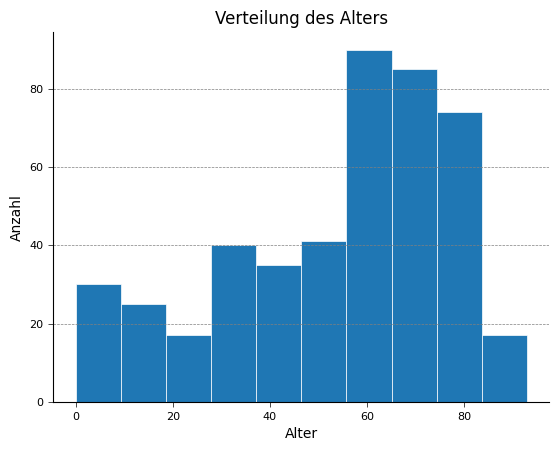

In [389]:
age_data = df.age[df.age.notna()].astype(int)

# Histogramm nach IBCS
plt.hist(age_data, bins=10, edgecolor='white', linewidth=0.5)

# Setze die Achsentitel
plt.xlabel('Alter')
plt.ylabel('Anzahl')

# Setze den Titel des Histogramms
plt.title('Verteilung des Alters')

# Entferne die obere und rechte Achsenlinie
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Setze die Achsentick-Positionierung
plt.gca().tick_params(axis='both', which='both', direction='out')
plt.gca().xaxis.set_tick_params(width=0.5)
plt.gca().yaxis.set_tick_params(width=0.5)

# Setze die Achsentick-Labels
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)

# Setze die Achsentick-Linien
plt.gca().yaxis.grid(color='gray', linestyle='--', linewidth=0.5)

### Geschlecht

### Funktion, um horizontale Barcharts der Häufigkeit zu erstellen

In [390]:
def top_n_barh(col, n, ylabel, title, size_x, size_y):
    
    # Wenn Spalte eine Liste ist, müssen Daten erst flach gemacht werden
    if type(col[0]) == list:
        list_vals = []
        for val in col:
            for i in val:
                list_vals.append(i)
    else:
        list_vals = col

    # Ereignisse zählen und ein dict erstellen
    vals_count = Counter(list_vals)
    vals_dict = dict(vals_count)
    if df.routes.equals(col):
        vals_dict = {key.capitalize(): value for key, value in vals_dict.items()}

    # Sortiere das Dictionary nach der Anzahl der Vorkommen absteigend
    sorted_vals_data = dict(sorted(vals_dict.items(), key=lambda x: x[1], reverse=True))

    # Falls Unknown in den ersten n vorkommt, muss es entfernt werden und später zu Other hinzugefügt werden
    if 'Unknown' in list(sorted_vals_data.keys())[:n]:
        # Entferne den Eintrag für 'Unknown' aus dem Dictionary
        unknown_count = sorted_vals_data.pop('Unknown')
        cat_title = 'Unknown & Other'
    else:
        unknown_count = 0
        cat_title = 'Other'

    # Extrahiere die n am häufigsten vorkommenden Länder und deren Anzahlen
    top_n_vals = list(sorted_vals_data.keys())[:n]
    top_n_vals_counts = list(sorted_vals_data.values())[:n]

    # Summiere die Werte für 'Other' + evtl. Unknown
    other_vals_count = sum(list(sorted_vals_data.values())[n:]) + unknown_count

    # Füge 'Other' und die Summe zu den Daten hinzu
    top_n_vals.append(cat_title)
    top_n_vals_counts.append(other_vals_count)

    # Erstelle das Balkendiagramm
    plt.figure(figsize=(size_x, size_y))
    plt.barh(top_n_vals, top_n_vals_counts)
    plt.xlabel('Anzahl')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.tight_layout()

    # Kehre die Reihenfolge der y-Achse um
    plt.gca().invert_yaxis()

### Reaktionen

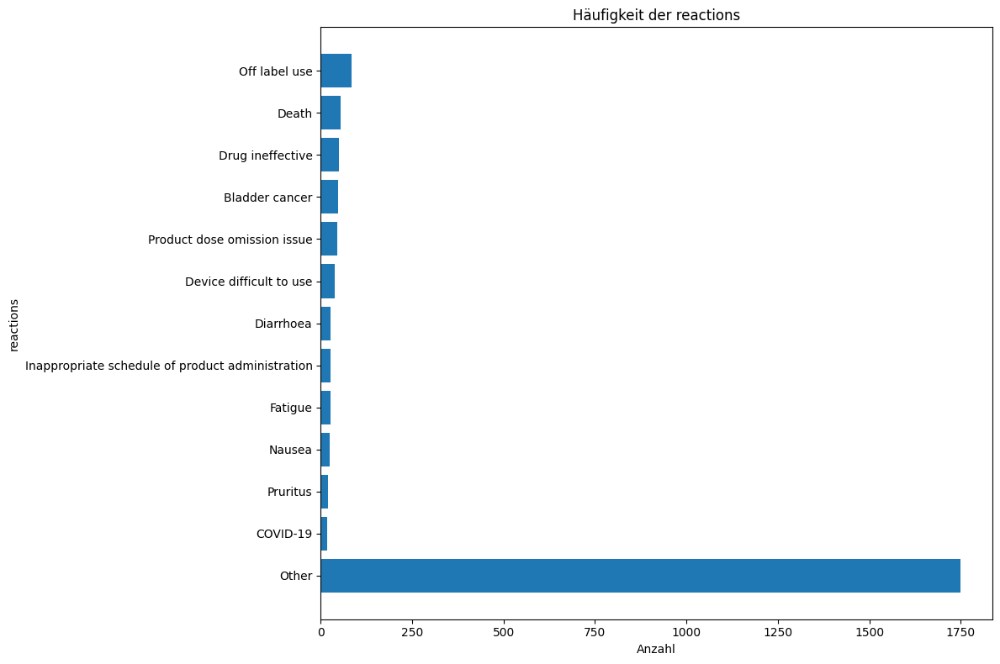

In [391]:
top_n_barh(df.reactions, 12, 'reactions', 'Häufigkeit der reactions', 12, 8)

(-0.5, 831.5, 321.5, -0.5)

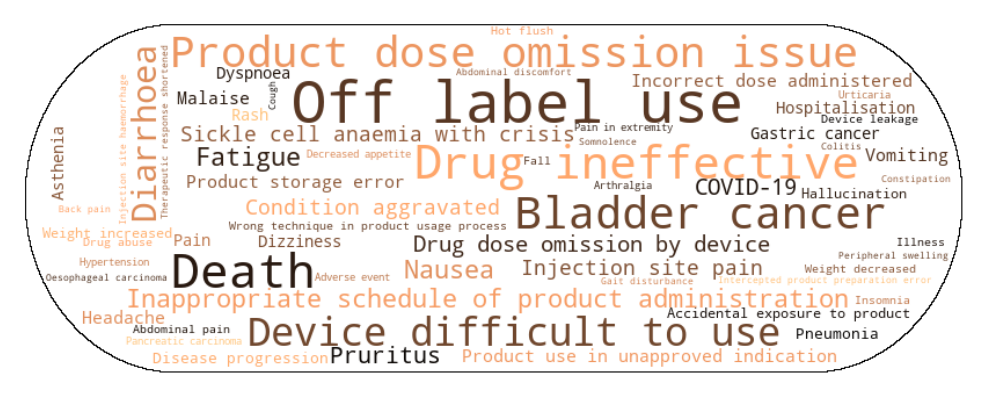

In [392]:
reactions = []
for reaction in df.reactions:
    for i in reaction:
        reactions.append(i)
reactions_count = Counter(reactions)
reactions_dict = dict(reactions_count)

pill_mask = np.array(Image.open('../Grafiken/Black_Pill.png'))
wordcloud = WordCloud(width=800, height=800, background_color='white', colormap='copper', mask = pill_mask, contour_width=1, min_font_size = 8, max_font_size=50, max_words=100)
wordcloud.generate_from_frequencies(reactions_dict)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.tight_layout(pad=0)
plt.axis('off')

### Land

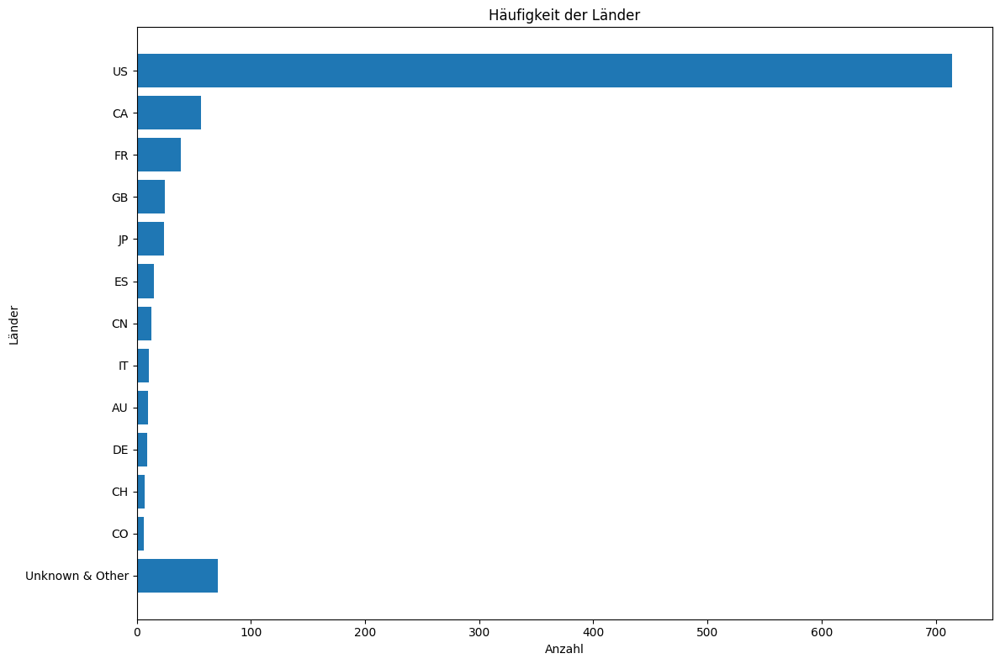

In [393]:
top_n_barh(df.primarysourcecountry, 12, 'Länder', 'Häufigkeit der Länder', 12, 8)

### Serious (Target-Variable)

Eventuell einfach als 2 Zahlen anzeigen lassen

In [394]:
serious_sum = df.serious.sum()
nots_sum = len(df) - serious_sum

### Route

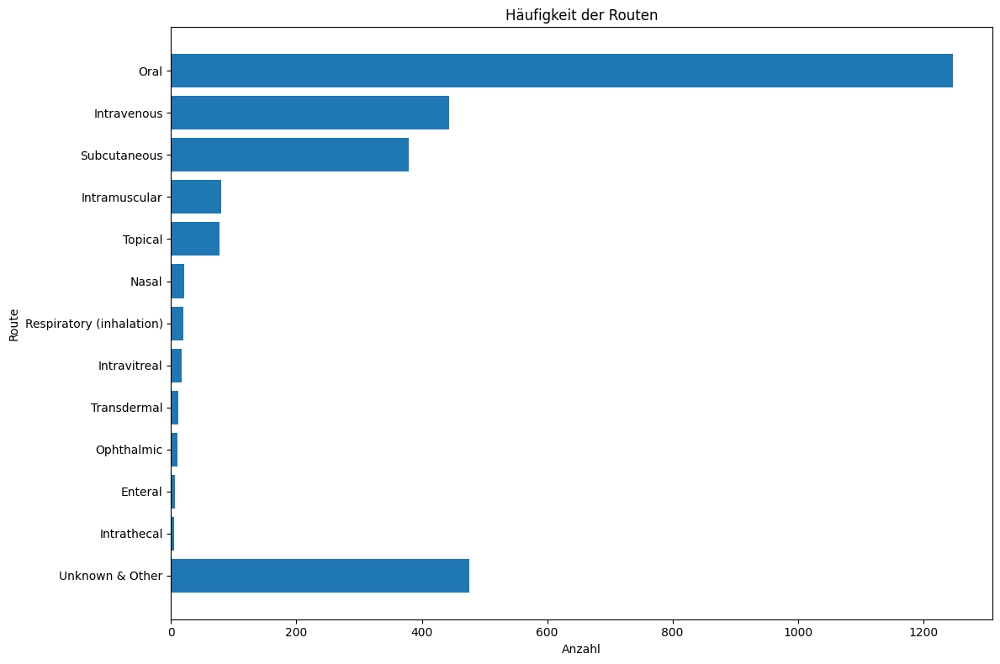

In [395]:
top_n_barh(df.routes, 12, 'Route', 'Häufigkeit der Routen', 12, 8)

### Reporttype

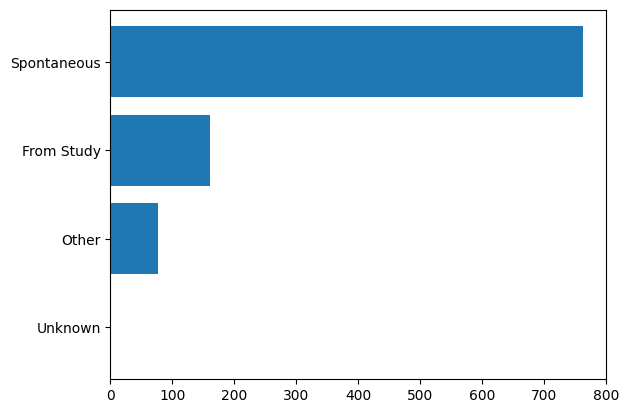

In [396]:
spon = df.report_spontaneous.sum()
study = df.report_from_study.sum()
other = df.report_other.sum()
unknown = df.report_unknown.sum()

plt.barh(['Spontaneous', 'From Study', 'Other', 'Unknown'], [spon, study, other, unknown])
plt.gca().invert_yaxis()

### Qualification

### Korrelation

wenig sinnvoll, da kategorische Variablen

In [397]:
corr = df.corr(numeric_only=True)
corr.dropna(axis=0, inplace=True, how='all')
corr.dropna(axis=1, inplace=True, how='all')

In [398]:
corr

,serious,min_one_pres,report_spontaneous,report_from_study,report_other,qualification_physician,qualification_pharmacist,qualification_other_health_prof,qualification_lawyer,qualification_consumer_or_nonhealth_prof,patientsex_male,patientsex_female,patientsex_unknown
serious,1.000000,-0.118074,-0.172364,0.144156,0.076601,0.142637,-0.035722,0.020093,0.192885,-0.193905,0.008168,-0.112446,0.121206
min_one_pres,-0.118074,1.000000,-0.078293,0.123949,-0.045813,0.125442,0.047747,0.125719,-0.473798,-0.018921,0.198964,0.200592,-0.456236
report_spontaneous,-0.172364,-0.078293,1.000000,-0.783828,-0.516813,0.112692,0.111533,0.110256,-0.042317,-0.209861,-0.100671,-0.008136,0.122591
report_from_study,0.144156,0.123949,-0.783828,1.000000,-0.126525,-0.122069,-0.099217,-0.114066,-0.097282,0.273532,0.076897,0.085692,-0.185798
report_other,0.076601,-0.045813,-0.516813,-0.126525,1.000000,-0.011729,-0.041382,-0.018871,0.201715,-0.041863,0.054802,-0.105141,0.060318
qualification_physician,0.142637,0.125442,0.112692,-0.122069,-0.011729,1.000000,-0.125533,-0.233584,-0.110344,-0.510986,0.039444,0.006249,-0.051581
qualification_pharmacist,-0.035722,0.047747,0.111533,-0.099217,-0.041382,-0.125533,1.000000,-0.118771,-0.056107,-0.259822,0.034760,-0.032326,-0.001587
qualification_other_health_prof,0.020093,0.125719,0.110256,-0.114066,-0.018871,-0.233584,-0.118771,1.000000,-0.104400,-0.483460,0.002552,-0.025072,0.026204
qualification_lawyer,0.192885,-0.473798,-0.042317,-0.097282,0.201715,-0.110344,-0.056107,-0.104400,1.000000,-0.228384,-0.163318,-0.186277,0.399570
qualification_consumer_or_nonhealth_prof,-0.193905,-0.018921,-0.209861,0.273532,-0.041863,-0.510986,-0.259822,-0.483460,-0.228384,1.000000,0.019225,0.108570,-0.147502


Text(0.5, 1.0, 'Korrelationsmatrix der Variablen')

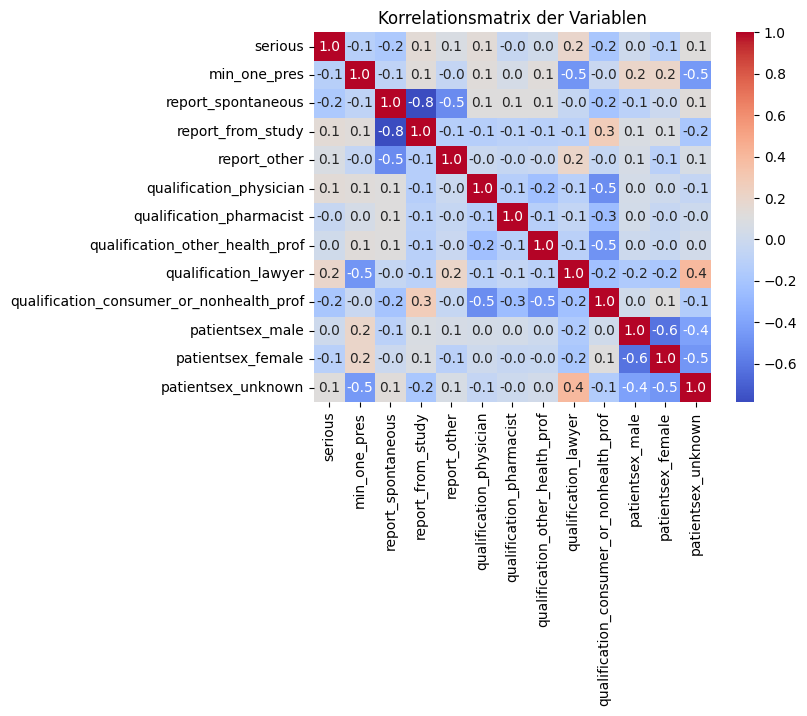

In [399]:
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".1f")
plt.title('Korrelationsmatrix der Variablen')

### Gestapelte Barcharts

In [43]:
df_serious = df['primarysource.reportercountry'][df.serious == 1]
df_ns = df['primarysource.reportercountry'][df.serious == 0]

KeyError: 'primarysource.reportercountry'

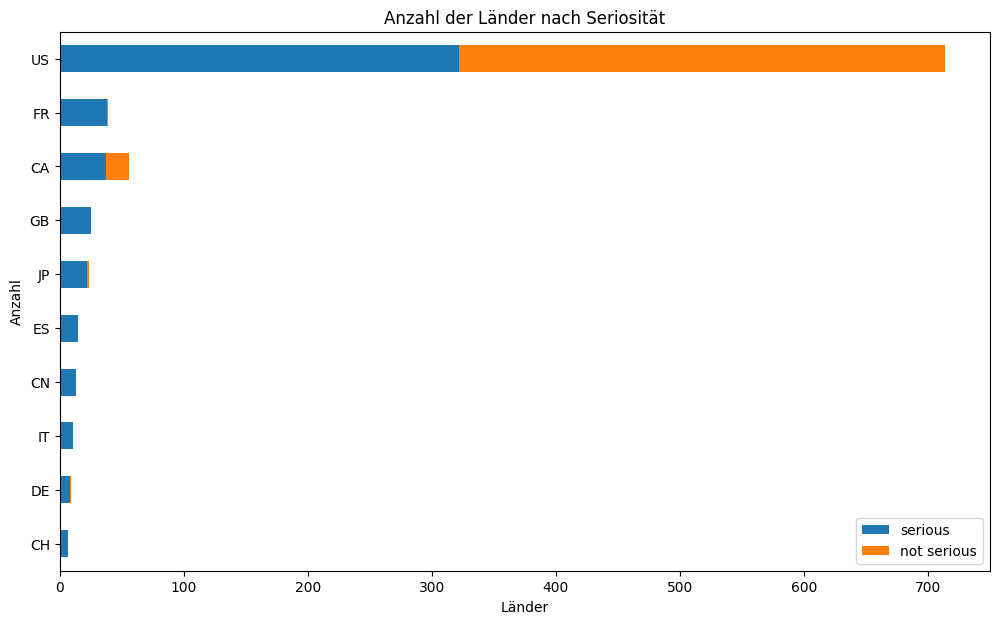

In [423]:
# Zuerst die Anzahl der Länder mit 'serious' zählen
serious_counts = df_serious.value_counts()

# Dann die Anzahl der Länder mit 'not serious' zählen
not_serious_counts = df_ns.value_counts()

# Daten kombinieren
combined_counts = pd.concat([serious_counts, not_serious_counts], axis=1, keys=['serious', 'not serious']).head(10)

# Balkendiagramm erstellen
combined_counts.plot(kind='barh', stacked=True, figsize=(12,7))

# Diagramm beschriften
plt.xlabel('Länder')
plt.ylabel('Anzahl')
plt.title('Anzahl der Länder nach Seriosität')

plt.gca().invert_yaxis()
plt.legend(loc=4)

In [45]:
df['age'][df.serious == 1].isna().sum()

36069

In [46]:
df['age'][df.serious == 0].isna().sum()

47832

In [48]:
df['age'].isna().sum()/len(df)

0.436984375

In [2]:
import pandas as pd
df = pd.read_pickle("../Daten/data_2019_preprocessed.pkl")

In [6]:
df_nn = df[df.age.notnull()]

In [8]:
len(df_nn[df_nn.serious == 1])/len(df_nn)

0.6138077132998455

In [ ]:
df.drop

## Weitere Vorverarbeitung

In [79]:
df = pd.read_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_data_analysis.pkl")

### Alter

In [80]:
df.age = pd.to_numeric(df.age)

### Country

In [3]:
df['primarysource.reportercountry'].value_counts()

primarysource.reportercountry
US    99152
FR     8904
GB     6399
CA     6037
JP     5640
      ...  
ML        1
MV        1
AX        1
PG        1
SY        1
Name: count, Length: 145, dtype: int64

In [81]:
### Top 10 Countries aus dem DF 2019 bekommen eigene Spalte, der Rest Other or Unknown. Damit DF nicht zu groß und falls neue Länder in neuen Daten kein Problem
# One-Hot-Encoding durchführen
top_countries = df['primarysource.reportercountry'].value_counts().nlargest(11).index.tolist()
df_encoded = pd.get_dummies(df['primarysource.reportercountry'].where(df['primarysource.reportercountry'].isin(top_countries), 'country_other_or_unknown'), dtype='int')
df_encoded.columns = ['country_' + col.lower() for col in df_encoded.columns]

# Country not specified zu other or unknown hinzufügen
df_encoded['country_country_other_or_unknown'] = df_encoded['country_country_other_or_unknown'] + df_encoded['country_country not specified']
df_encoded.drop('country_country not specified', axis=1, inplace=True)
df_encoded.rename(columns={"country_country_other_or_unknown": "country_other_or_unknown"}, inplace=True)

# DataFrame zusammenführen
df = pd.concat([df.drop('primarysource.reportercountry', axis=1), df_encoded], axis=1)

# Ergebnis anzeigen
df

,serious,receivedate,age,reactions,drugs,routes,min_one_pres,report_spontaneous,report_from_study,report_other,...,country_cn,country_de,country_es,country_fr,country_gb,country_it,country_jp,country_nl,country_us,country_other_or_unknown
0,1,2019-12-11,53,"[Head and neck cancer, Anaemia, Drug ineffecti...","[ETORICOXIB., PREGABALIN.]","[Unknown, ORAL]",1,1,0,0,...,0,0,0,0,0,0,0,0,0,1
1,1,2019-11-20,10,[Acquired haemophilia],"[METHOTREXATE., VESICARE]","[INTRAMUSCULAR, ORAL]",1,1,0,0,...,0,0,0,0,0,0,1,0,0,0
2,0,2019-12-04,74,[Influenza],"[HYZAAR, COZAAR]","[ORAL, ORAL]",1,1,0,0,...,0,0,0,0,0,0,0,0,1,0
3,1,2019-12-05,67,"[Rash papular, Exfoliative rash, Adenocarcinom...","[PANITUMUMAB, FOLINIC ACID, BETOPTIC, DOXYCYCL...","[INTRAVENOUS, Unknown, Unknown, ORAL, ORAL, Un...",1,1,0,0,...,0,0,0,0,0,0,0,0,0,1
4,1,2019-12-05,77,"[Bradycardia, Sinus node dysfunction, Syncope]","[ALLOPURINOL., BISOPROLOL, ARANESP, ACETYLSALI...","[INTRAVENOUS, ORAL, INTRAVENOUS, ORAL, Unknown...",1,1,0,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
158734,1,2019-08-26,46,"[Depression, Suicidal ideation]",[OTEZLA],[ORAL],1,1,0,0,...,0,0,0,0,0,0,0,0,1,0
158735,1,2019-06-06,84,[Acute myocardial infarction],"[ROSUVASTATINE [ROSUVASTATIN CALCIUM], BAYASPI...","[Unknown, Unknown, Unknown, Unknown, SUBCUTANE...",1,1,0,0,...,0,0,0,0,0,0,1,0,0,0
158736,0,2019-07-24,78,"[Accidental exposure to product, Occupational ...",[ARANESP],[INTRAVENOUS],1,1,0,0,...,0,0,0,0,0,0,0,0,1,0
158737,1,2019-08-08,84,[Chest pain],[ARANESP],[INTRAVENOUS],1,0,1,0,...,0,0,0,0,0,0,0,0,0,1


In [87]:
df.filter(regex="country").columns

Index(['country_ca', 'country_cn', 'country_de', 'country_es', 'country_fr',
       'country_gb', 'country_it', 'country_jp', 'country_nl', 'country_us',
       'country_other_or_unknown'],
      dtype='object')

In [23]:
'''
df = pd.get_dummies(df, prefix='country', columns=['primarysource.reportercountry'], dtype='int')
df.rename(columns={"country_COUNTRY NOT SPECIFIED": "country_unknown"}, inplace=True)
'''

### Routes

In [78]:
'''
routes = pd.get_dummies(df.routes.explode(), prefix='route').groupby(level=0).sum()
df = pd.concat([df, routes], axis=1)
df.drop(['routes'], axis=1, inplace=True)
'''

In [37]:
df.filter(regex='route').sum(axis=0).sort_values(ascending=False)

route_oral                        211548
route_unknown                     164658
route_intravenous                  50486
route_subcutaneous                 32420
route_topical                      30394
route_intramuscular                16263
route_respiratory (inhalation)      5696
route_intravitreal                  5281
route_intrauterine                  3264
route_ophthalmic                    3088
route_transdermal                   2456
route_nasal                         1832
route_intra-arterial                1349
route_vaginal                        812
route_sublingual                     607
route_intradermal                    593
route_rectal                         265
route_intraperitoneal                227
route_intrathecal                    207
route_auricular (otic)               189
route_intraventricular               174
route_enteral                        120
route_parenteral                     113
route_intralesional                   79
route_infiltrati

In [82]:
# Frequency Encoding durchführen
routes_counts = df['routes'].explode().value_counts()
top_routes = routes_counts.nlargest(17).index.tolist()
df['routes_encoded'] = df['routes'].apply(lambda x: [route if route in top_routes else 'route_other_or_unknown' for route in x])
df_encoded = pd.get_dummies(df['routes_encoded'].explode(), prefix='route').groupby(level=0).sum()
df_encoded.route_route_other_or_unknown += df_encoded.route_Unknown
df_encoded.drop(['route_Unknown'],axis=1,inplace=True)
df_encoded.rename(columns={"route_route_other_or_unknown":"route_other_or_unknown"}, inplace=True)

# DataFrame zusammenführen
df = pd.concat([df.drop(['routes', 'routes_encoded'], axis=1), df_encoded], axis=1)

In [62]:
df.filter(regex='route').sum(axis=0).sort_values(ascending=False)

route_ORAL                        211548
route_other_or_unknown            166333
route_INTRAVENOUS                  50486
route_SUBCUTANEOUS                 32420
route_TOPICAL                      30394
route_INTRAMUSCULAR                16263
route_RESPIRATORY (INHALATION)      5696
route_INTRAVITREAL                  5281
route_INTRAUTERINE                  3264
route_OPHTHALMIC                    3088
route_TRANSDERMAL                   2456
route_NASAL                         1832
route_INTRA-ARTERIAL                1349
route_VAGINAL                        812
route_SUBLINGUAL                     607
route_INTRADERMAL                    593
route_RECTAL                         265
dtype: int64

In [88]:
df.filter(regex='route').columns

Index(['route_intra-arterial', 'route_intradermal', 'route_intramuscular',
       'route_intrauterine', 'route_intravenous', 'route_intravitreal',
       'route_nasal', 'route_ophthalmic', 'route_oral', 'route_rectal',
       'route_respiratory (inhalation)', 'route_subcutaneous',
       'route_sublingual', 'route_topical', 'route_transdermal',
       'route_vaginal', 'route_other_or_unknown'],
      dtype='object')

### Drugs & Reactions (auch nutzen?!)

In [72]:
# Frequency Encoding durchführen
reactions_counts = df['reactions'].explode().value_counts()
reactions_counts.head(20)

reactions
Drug ineffective                                    8851
Off label use                                       6817
Nausea                                              6114
Death                                               6072
Fatigue                                             5717
Diarrhoea                                           5087
Headache                                            4901
Dyspnoea                                            4360
Erythema                                            4292
Rash                                                4028
Vomiting                                            3720
Product dose omission                               3708
Dizziness                                           3656
Product use in unapproved indication                3609
Dry skin                                            3375
Malaise                                             3360
Pruritus                                            3356
Skin burning sensatio

In [73]:
drug_counts = df['drugs'].explode().value_counts()
drug_counts.head(20)

drugs
PROACTIV MD ADAPALENE ACNE TREATMENT    9781
PROACTIV MD DEEP CLEANSING FACE WASH    8881
PROACTIV MD DAILY OIL CONTROL SPF 30    8669
REVLIMID                                6563
PROACTIV GREEN TEA MOISTURIZER          5367
DEXAMETHASONE.                          4854
ENBREL                                  4657
PREDNISONE.                             4457
GABAPENTIN.                             4354
LYRICA                                  4060
OTEZLA                                  3275
METFORMIN                               3133
METHOTREXATE.                           2818
ELIQUIS                                 2787
AMLODIPINE                              2784
XARELTO                                 2781
MYCOPHENOLATE MOFETIL.                  2752
IBRANCE                                 2692
FUROSEMIDE.                             2489
ATORVASTATIN                            2482
Name: count, dtype: int64

In [83]:
df.columns = df.columns.str.lower()

In [84]:
df.drop(['reactions', 'drugs'], axis=1, inplace=True)

## Ergebnis als Pickle abspeichern

In [89]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158739 entries, 0 to 158738
Data columns (total 44 columns):
 #   Column                                    Non-Null Count   Dtype         
---  ------                                    --------------   -----         
 0   serious                                   158739 non-null  int64         
 1   receivedate                               158739 non-null  datetime64[ns]
 2   age                                       158739 non-null  int64         
 3   min_one_pres                              158739 non-null  int64         
 4   report_spontaneous                        158739 non-null  int64         
 5   report_from_study                         158739 non-null  int64         
 6   report_other                              158739 non-null  int64         
 7   report_unknown                            158739 non-null  int64         
 8   qualification_physician                   158739 non-null  int64         
 9   qualification_p

In [86]:
df.to_pickle(r"C:\Users\Paul Strohmeier\Desktop\Drug-data\pickle\data2019_ml_ready.pkl")